## IMPORTING NECESSARY MODULES

In [3]:
import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16
from keras import models,layers
from keras.optimizers import SGD, Adam
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.vgg16 import preprocess_input as preprocess_input_vgg16
from tensorflow.keras.layers.experimental.preprocessing import RandomFlip
import os
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.image import imread
from PIL import Image
from sklearn.metrics import confusion_matrix
from keras.preprocessing.image import ImageDataGenerator

## SETTING TEST,TRAIN AND VALIDATION IMAGES DIRECTORY


In [4]:
train_dir='C:/jayjeet/dnn/train_images'
test_dir='C:/jayjeet/dnn/test_images'
vald_dir='C:/jayjeet/dnn/vald_images'

## IMPORTING DATA

In [96]:
train_datagen =  ImageDataGenerator(
    preprocessing_function=preprocess_input_vgg16
)

validation_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_vgg16
)
test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_vgg16
)

train_data = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical')

val_data = validation_datagen.flow_from_directory(
        vald_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)

test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)


Found 8855 images belonging to 10 classes.
Found 1555 images belonging to 10 classes.
Found 1551 images belonging to 10 classes.


## SHOWING PCTURES

In [67]:

def show_images(dataset_path, class_labels, num_images=4, image_size=(400, 400)):
    plt.figure(figsize=(100,100))

    for i, class_label in enumerate(class_labels):
        class_path = os.path.join(dataset_path, class_label)
        image_files = os.listdir(class_path)[:num_images]

        for j, image_file in enumerate(image_files):
            plt.subplot(len(class_labels), num_images, i * num_images + j + 1)

            # Load and display the image with increased size
            image_path = os.path.join(class_path, image_file)
            img = Image.open(image_path)
            img = img.resize(image_size)  # Resize the image
            img = img.convert('RGB')  # Ensure the image is in RGB format
            plt.imshow(img)
            
            plt.title(class_label, fontsize=50)
            plt.axis("off")

    plt.subplots_adjust(wspace=0.2, hspace=0.2)  # Add space between subplots
    plt.show()

show_images(train_dir, class_labels)



## VGG16 MODEL

In [18]:
vgg16_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))
vgg16_model.trainable = False
vgg16_model.summary()


Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0     

## ADDING TOP LAYERS


In [19]:
model = models.Sequential()
model.add(layers.Input(shape=(224,224,3)))
model.add(tf.keras.layers.Lambda(lambda x: tf.image.random_flip_left_right(x), input_shape=(224, 224, 3)))
model.add(vgg16_model)
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Dense(512, activation='relu'))
model.add(layers.BatchNormalization())
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dropout(0.15))
model.add(layers.BatchNormalization())
model.add(layers.Dense(64, activation='relu'))
model.add(layers.Dropout(0.3))
model.add(layers.BatchNormalization())
model.add(layers.Dense(10, activation='softmax'))



## COMPILING THE MODEL VGG 16

In [20]:
model.compile(
   Adam(learning_rate = 0.001), loss='categorical_crossentropy', metrics=['acc'])
historyVgg16 =model.fit(train_data, 
      steps_per_epoch=train_data.samples/train_data.batch_size,
      epochs=5,
      validation_data=val_data,
      validation_steps=val_data.samples/val_data.batch_size,
      verbose=1)

Epoch 1/5
138/138 [==============================] - 1414s 10s/step - loss: 1.4258 - acc: 0.5452 - val_loss: 0.8757 - val_acc: 0.7357
Epoch 2/5
138/138 [==============================] - 1348s 10s/step - loss: 0.6865 - acc: 0.7903 - val_loss: 0.6082 - val_acc: 0.8090
Epoch 3/5
138/138 [==============================] - 1348s 10s/step - loss: 0.4329 - acc: 0.8723 - val_loss: 0.4939 - val_acc: 0.8553
Epoch 4/5
138/138 [==============================] - 1496s 11s/step - loss: 0.3071 - acc: 0.9107 - val_loss: 0.5233 - val_acc: 0.8514
Epoch 5/5
138/138 [==============================] - 1655s 12s/step - loss: 0.2490 - acc: 0.9276 - val_loss: 0.4066 - val_acc: 0.8797


## SAVE AND LOAD MODEL

In [21]:
model.save('C:/jayjeet/dnn/mod_vgg16.h5')

C:\Users\DELL\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [22]:
model.save_weights('C:/jayjeet/dnn/mod_vgg16_weights.h5')

In [99]:
loaded_model = tf.keras.models.load_model('C:/jayjeet/dnn/mod_vgg16.h5')
loaded_model.load_weights('C:/jayjeet/dnn/mod_vgg16_weights.h5')

## SHOWING GRAPH FOR LOSS AND ACCURACY

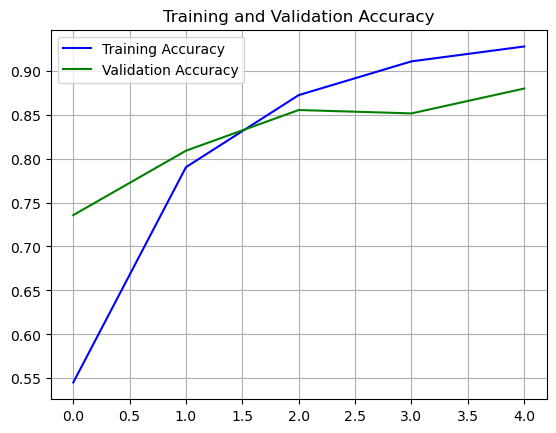

<Figure size 640x480 with 0 Axes>

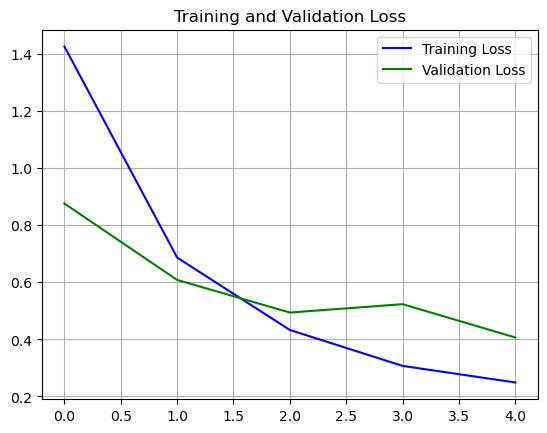

In [28]:
train_acc = historyVgg16 .history['acc']
val_acc = historyVgg16.history['val_acc']
train_loss = historyVgg16 .history['loss']
val_loss = historyVgg16.history['val_loss']
train_acc = historyVgg16.history['acc']
val_acc = historyVgg16.history['val_acc']
train_loss = historyVgg16.history['loss']
val_loss = historyVgg16.history['val_loss']
epochs = range(len(train_acc)) 
plt.plot(epochs, train_acc, 'b', label='Training Accuracy')
plt.plot(epochs, val_acc, 'g', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.grid()
plt.legend()
plt.figure()
plt.show()

plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'g', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.grid()
plt.legend()
plt.show()


## SHOWING TEST ACCURACY AND CONFUSION MATRIX

In [97]:

true_labels = test_generator.classes
class_index= test_generator.class_indices
class_name = dict((v,k) for k,v in class_index.items())
predictions = loaded_model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)


C:\Users\DELL\AppData\Local\Temp\ipykernel_11492\2571854327.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  predictions = loaded_model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)


24/24 [==============================] - 210s 9s/step


In [119]:
errors = np.where(predicted_classes != true_labels)[0]
accuracy = ((test_generator.samples-len(errors))/test_generator.samples) * 100
accuracy

86.9116698903933

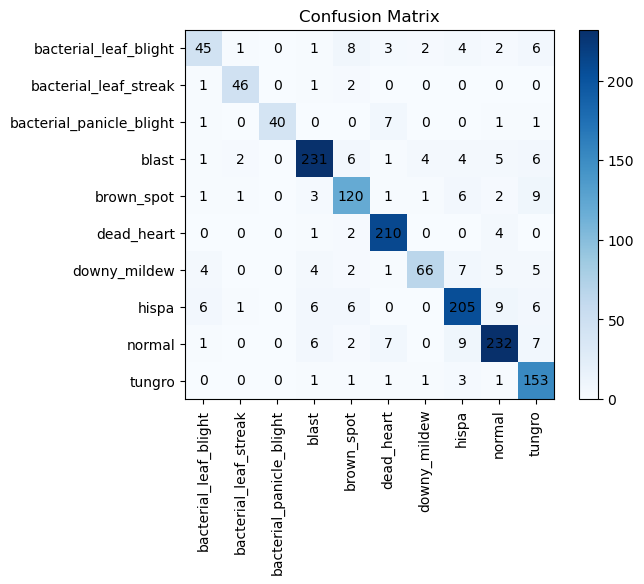

In [120]:
class_labellling = [class_label for class_label in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, class_label))]
conf_matrix= confusion_matrix(y_true=true_labels, y_pred=predicted_classes)
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

class_labels = [str(label) for label in np.unique(true_labels)]
plt.xticks(np.arange(len(class_name)), class_labellling, rotation=90)
plt.yticks(np.arange(len(class_name)), class_labellling)

# Display the values in the cells
for i in range(len(class_name)):
    for j in range(len(class_name)):
        plt.text(j, i, str(conf_matrix[i, j]), ha='center', va='center', color='black')

plt.show()

In [100]:
from sklearn.metrics import classification_report
print(classification_report(true_labels, predicted_classes, target_names=class_index))

                          precision    recall  f1-score   support

   bacterial_leaf_blight       0.82      0.64      0.72        72
   bacterial_leaf_streak       0.96      0.90      0.93        50
bacterial_panicle_blight       1.00      0.82      0.90        50
                   blast       0.90      0.89      0.90       260
              brown_spot       0.80      0.84      0.82       144
              dead_heart       0.91      0.96      0.94       217
            downy_mildew       0.92      0.73      0.82        94
                   hispa       0.87      0.88      0.87       239
                  normal       0.89      0.88      0.88       264
                  tungro       0.81      0.96      0.88       161

                accuracy                           0.88      1551
               macro avg       0.89      0.85      0.87      1551
            weighted avg       0.88      0.88      0.88      1551



## MOBILENET

In [10]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_input_mobilenetv2


## IMPORTING DATA

In [11]:
train_datagen =  ImageDataGenerator(
    preprocessing_function=preprocess_input_mobilenetv2
)

validation_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_mobilenetv2
)
test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_mobilenetv2
)

train_data = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical')

val_data = validation_datagen.flow_from_directory(
        vald_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)

test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)

Found 8855 images belonging to 10 classes.
Found 1555 images belonging to 10 classes.
Found 1551 images belonging to 10 classes.


In [36]:
MobileNetV2_model=MobileNetV2(input_shape=(224,224,3),
                                         include_top=False,
                                         weights='imagenet')
MobileNetV2_model.trainable = False
MobileNetV2_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_11 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_11[0][0]']            
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[

## TOP LAYERS

In [37]:
ModelV = models.Sequential()
ModelV.add(layers.Input(shape=(224, 224, 3)))
ModelV.add(layers.Lambda(lambda x: tf.image.random_flip_left_right(x)))
ModelV.add(MobileNetV2_model)
ModelV.add(layers.Flatten())
ModelV.add(layers.Dense(1024, activation='relu'))
ModelV.add(layers.BatchNormalization())
ModelV.add(layers.Dense(512, activation='relu'))
ModelV.add(layers.BatchNormalization())
ModelV.add(layers.Dense(128, activation='relu'))
ModelV.add(layers.Dropout(0.15))
ModelV.add(layers.BatchNormalization())
ModelV.add(layers.Dense(64, activation='relu'))
ModelV.add(layers.Dropout(0.3))
ModelV.add(layers.BatchNormalization())
ModelV.add(layers.Dense(10, activation='softmax'))
ModelV.summary()

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lambda_6 (Lambda)           (None, 224, 224, 3)       0         
                                                                 
 mobilenetv2_1.00_224 (Func  (None, 7, 7, 1280)        2257984   
 tional)                                                         
                                                                 
 flatten_3 (Flatten)         (None, 62720)             0         
                                                                 
 dense_30 (Dense)            (None, 1024)              64226304  
                                                                 
 batch_normalization_24 (Ba  (None, 1024)              4096      
 tchNormalization)                                               
                                                                 
 dense_31 (Dense)            (None, 512)              

In [38]:
ModelV.compile(
   Adam(learning_rate = 0.001), loss='categorical_crossentropy', metrics=['acc'])
historyV =ModelV.fit(train_data, 
      steps_per_epoch=train_data.samples/train_data.batch_size,
      epochs=5,
      validation_data=val_data,
      validation_steps=val_data.samples/val_data.batch_size,
      verbose=1)

Epoch 1/5
138/138 [==============================] - 174s 1s/step - loss: 1.3648 - acc: 0.5592 - val_loss: 0.8033 - val_acc: 0.7511
Epoch 2/5
138/138 [==============================] - 172s 1s/step - loss: 0.6845 - acc: 0.7985 - val_loss: 0.6219 - val_acc: 0.8090
Epoch 3/5
138/138 [==============================] - 173s 1s/step - loss: 0.4384 - acc: 0.8746 - val_loss: 0.4769 - val_acc: 0.8514
Epoch 4/5
138/138 [==============================] - 174s 1s/step - loss: 0.3049 - acc: 0.9147 - val_loss: 0.4283 - val_acc: 0.8662
Epoch 5/5
138/138 [==============================] - 178s 1s/step - loss: 0.2339 - acc: 0.9293 - val_loss: 0.4308 - val_acc: 0.8759


## SAVE AND LOAD MODEL

In [39]:
ModelV.save('C:/jayjeet/dnn/ModelV2.h5')
ModelV.save_weights('C:/jayjeet/dnn/ModelV_weight.h5')


In [13]:
loaded_model = tf.keras.models.load_model('C:/jayjeet/dnn/ModelV2.h5')
loaded_model.load_weights('C:/jayjeet/dnn/ModelV_weight.h5')

In [45]:
## LOSS AND ACCURACY GRAPH

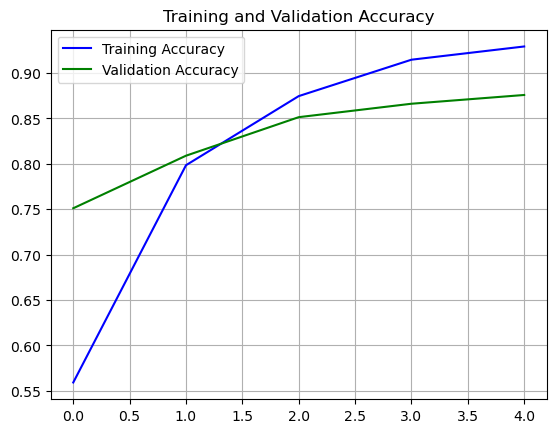

<Figure size 640x480 with 0 Axes>

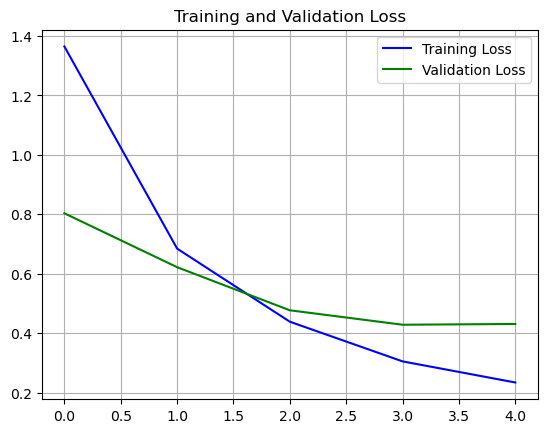

In [41]:
train_acc =  historyV.history['acc']
val_acc = historyV.history['val_acc']
train_loss = historyV.history['loss']
val_loss = historyV.history['val_loss']
train_acc = historyV.history['acc']
val_acc = historyV.history['val_acc']
train_loss = historyV.history['loss']
val_loss = historyV.history['val_loss']
epochs = range(len(train_acc)) 
plt.plot(epochs, train_acc, 'b', label='Training Accuracy')
plt.plot(epochs, val_acc, 'g', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.grid()
plt.legend()
plt.figure()
plt.show()

plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'g', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.grid()
plt.legend()
plt.show()


## TEST ACCURACY AND CONFUSION MATRIX

In [15]:
true_labels = test_generator.classes
class_index= test_generator.class_indices
class_name = dict((v,k) for k,v in class_index.items())
predictions =loaded_model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

C:\Users\DELL\AppData\Local\Temp\ipykernel_18200\444108508.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  predictions =loaded_model.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)


24/24 [==============================] - 26s 1s/step


In [43]:
errors = np.where(predicted_classes != true_labels)[0]
accuracy = ((test_generator.samples-len(errors))/test_generator.samples) * 100
accuracy

87.36299161831077

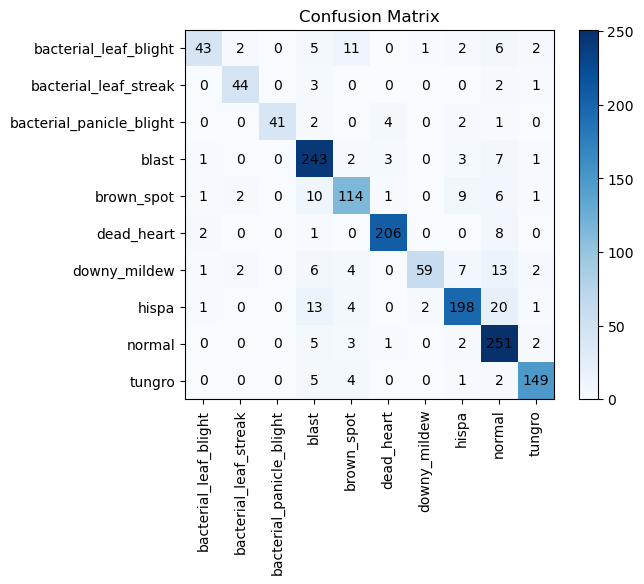

In [16]:
class_labellling = [class_label for class_label in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, class_label))]
conf_matrix= confusion_matrix(y_true=true_labels, y_pred=predicted_classes)
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

class_labels = [str(label) for label in np.unique(true_labels)]
plt.xticks(np.arange(len(class_name)), class_labellling, rotation=90)
plt.yticks(np.arange(len(class_name)), class_labellling)

# Display the values in the cells
for i in range(len(class_name)):
    for j in range(len(class_name)):
        plt.text(j, i, str(conf_matrix[i, j]), ha='center', va='center', color='black')

plt.show()

In [94]:
from sklearn.metrics import classification_report
print(classification_report(true_labels, predicted_classes, target_names=class_index))

                          precision    recall  f1-score   support

   bacterial_leaf_blight       0.88      0.60      0.71        72
   bacterial_leaf_streak       0.90      0.86      0.88        50
bacterial_panicle_blight       0.97      0.78      0.87        50
                   blast       0.84      0.94      0.89       260
              brown_spot       0.82      0.85      0.84       144
              dead_heart       0.94      0.97      0.95       217
            downy_mildew       0.97      0.68      0.80        94
                   hispa       0.89      0.80      0.84       239
                  normal       0.80      0.93      0.86       264
                  tungro       0.93      0.94      0.93       161

                accuracy                           0.87      1551
               macro avg       0.89      0.83      0.86      1551
            weighted avg       0.88      0.87      0.87      1551



## RESNET

## LOADING DATA

In [5]:
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_input_res
train_datagen =  ImageDataGenerator(
    preprocessing_function=preprocess_input_res
)

validation_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_res
)
test_datagen = ImageDataGenerator(
    preprocessing_function=preprocess_input_res
)

train_data = train_datagen.flow_from_directory(
        train_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical')

val_data = validation_datagen.flow_from_directory(
        vald_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)

test_generator = test_datagen.flow_from_directory(
        test_dir,
        target_size=(224, 224),
        batch_size=64,
        class_mode='categorical',
        shuffle=False)

Found 8855 images belonging to 10 classes.
Found 1555 images belonging to 10 classes.
Found 1551 images belonging to 10 classes.


In [26]:
from tensorflow.keras.applications import ResNet50
from tensorflow.keras import layers, models


resnet50_model = ResNet50(weights='imagenet', input_shape=(224, 224, 3), include_top=False)
resnet50_model.trainable = False
resnet50_model.summary()


Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_8[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

## ADDING TOP LAYERS

In [27]:
modelRes = models.Sequential()
modelRes.add(layers.Input(shape=(224, 224, 3)))
modelRes.add(layers.Lambda(lambda x: tf.image.random_flip_left_right(x)))
modelRes.add(resnet50_model)
modelRes.add(layers.Flatten())
modelRes.add(layers.Dense(1024, activation='relu'))
modelRes.add(layers.BatchNormalization())
modelRes.add(layers.Dense(512, activation='relu'))
modelRes.add(layers.BatchNormalization())
modelRes.add(layers.Dense(128, activation='relu'))
modelRes.add(layers.Dropout(0.15))
modelRes.add(layers.BatchNormalization())
modelRes.add(layers.Dense(64, activation='relu'))
modelRes.add(layers.Dropout(0.3))
modelRes.add(layers.BatchNormalization())
modelRes.add(layers.Dense(10, activation='softmax'))
modelRes.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lambda_4 (Lambda)           (None, 224, 224, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 7, 7, 2048)        23587712  
                                                                 
 flatten_1 (Flatten)         (None, 100352)            0         
                                                                 
 dense_20 (Dense)            (None, 1024)              102761472 
                                                                 
 batch_normalization_16 (Ba  (None, 1024)              4096      
 tchNormalization)                                               
                                                                 
 dense_21 (Dense)            (None, 512)               524800    
                                                      

In [28]:
modelRes.compile(
   Adam(learning_rate = 0.001), loss='categorical_crossentropy', metrics=['acc'])
historyRes =modelRes.fit(train_data, 
      steps_per_epoch=train_data.samples/train_data.batch_size,
      epochs=5,
      validation_data=val_data,
      validation_steps=val_data.samples/val_data.batch_size,
      verbose=1)

Epoch 1/5
138/138 [==============================] - 587s 4s/step - loss: 1.3648 - acc: 0.5587 - val_loss: 0.7708 - val_acc: 0.7595
Epoch 2/5
138/138 [==============================] - 636s 5s/step - loss: 0.6263 - acc: 0.8122 - val_loss: 0.4785 - val_acc: 0.8534
Epoch 3/5
138/138 [==============================] - 627s 5s/step - loss: 0.3662 - acc: 0.8966 - val_loss: 0.4156 - val_acc: 0.8836
Epoch 4/5
138/138 [==============================] - 572s 4s/step - loss: 0.2405 - acc: 0.9374 - val_loss: 0.3158 - val_acc: 0.9080
Epoch 5/5
138/138 [==============================] - 558s 4s/step - loss: 0.1937 - acc: 0.9440 - val_loss: 0.3338 - val_acc: 0.8958


In [29]:
modelRes.save("C:/jayjeet/dnn/modelRe.h5")

C:\Users\DELL\anaconda3\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


## SAVE AND LOAD MODEL

In [30]:
modelRes.save_weights('C:/jayjeet/dnn/modelRes_wei.h5')

In [6]:
load = tf.keras.models.load_model('C:/jayjeet/dnn/modelRe.h5')
load.load_weights('C:/jayjeet/dnn/modelRes_wei.h5')

## GRAPH FOR ACCURACY AND LOSS

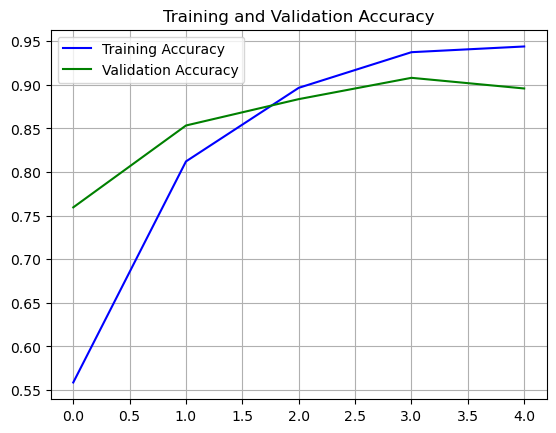

<Figure size 640x480 with 0 Axes>

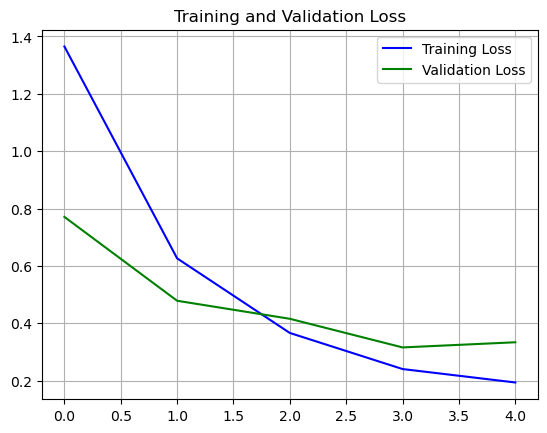

In [85]:
train_acc = historyRes.history['acc']
val_acc =historyRes.history['val_acc']
train_loss = historyRes.history['loss']
val_loss=historyRes.history['val_loss']
train_acc = historyRes.history['acc']
val_acc = historyRes.history['val_acc']
train_loss = historyRes.history['loss']
val_loss =historyRes.history['val_loss']
epochs = range(len(train_acc)) 
plt.plot(epochs, train_acc, 'b', label='Training Accuracy')
plt.plot(epochs, val_acc, 'g', label='Validation Accuracy')
plt.title('Training and Validation Accuracy')
plt.grid()
plt.legend()
plt.figure()
plt.show()
plt.plot(epochs, train_loss, 'b', label='Training Loss')
plt.plot(epochs, val_loss, 'g', label='Validation Loss')
plt.title('Training and Validation Loss')
plt.grid()
plt.legend()
plt.show()

## TESTING ACCURACY AND CONFUSION MATRIX


In [7]:
true_labels = test_generator.classes
class_index= test_generator.class_indices
class_name = dict((v,k) for k,v in class_index.items())
predictions =load.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

C:\Users\DELL\AppData\Local\Temp\ipykernel_18200\1564390165.py:4: UserWarning: `Model.predict_generator` is deprecated and will be removed in a future version. Please use `Model.predict`, which supports generators.
  predictions =load.predict_generator(test_generator, steps=test_generator.samples/test_generator.batch_size,verbose=1)


24/24 [==============================] - 74s 3s/step


In [87]:
errors = np.where(predicted_classes != true_labels)[0]

In [88]:

accu = ((test_generator.samples-len(errors))/test_generator.samples) * 100
accu


89.87749838813669

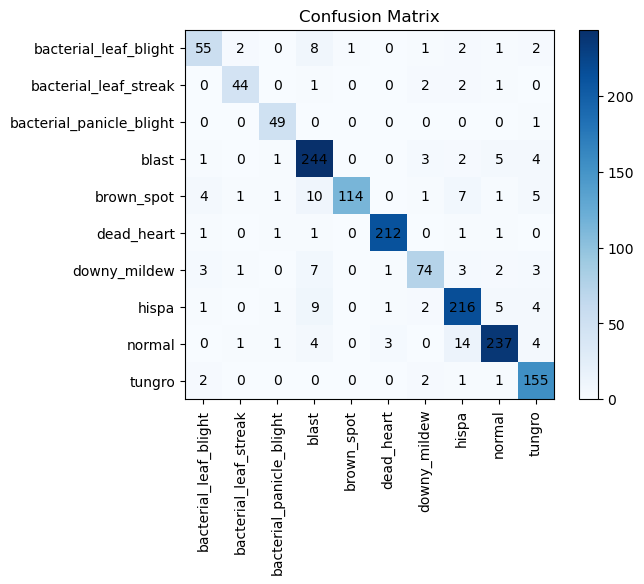

In [8]:
class_labellling = [class_label for class_label in os.listdir(test_dir) if os.path.isdir(os.path.join(test_dir, class_label))]
conf_matrix= confusion_matrix(y_true=true_labels, y_pred=predicted_classes)
plt.imshow(conf_matrix, interpolation='nearest', cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.colorbar()

class_labels = [str(label) for label in np.unique(true_labels)]
plt.xticks(np.arange(len(class_name)), class_labellling, rotation=90)
plt.yticks(np.arange(len(class_name)), class_labellling)

# Display the values in the cells
for i in range(len(class_name)):
    for j in range(len(class_name)):
        plt.text(j, i, str(conf_matrix[i, j]), ha='center', va='center', color='black')

plt.show()

In [91]:
from sklearn.metrics import classification_report
print(classification_report(true_labels, predicted_classes, target_names=class_index))

                          precision    recall  f1-score   support

   bacterial_leaf_blight       0.86      0.75      0.80        72
   bacterial_leaf_streak       0.92      0.94      0.93        50
bacterial_panicle_blight       0.89      0.98      0.93        50
                   blast       0.85      0.93      0.89       260
              brown_spot       0.98      0.76      0.85       144
              dead_heart       0.97      0.98      0.97       217
            downy_mildew       0.88      0.81      0.84        94
                   hispa       0.86      0.90      0.88       239
                  normal       0.94      0.88      0.91       264
                  tungro       0.86      0.96      0.91       161

                accuracy                           0.90      1551
               macro avg       0.90      0.89      0.89      1551
            weighted avg       0.90      0.90      0.90      1551

